# Image Augmentations for Training Convolutional Netural Networks for Tree Genera Classification

The following Jupyter Notebook includes code to examine effects of image augmentation on AutoArborist tree data.

The code build on proposed image augmentation strategies used in Lumnitz et al., 2021: Mapping trees along urban street networks with deep learning and street-level imagery.

Lumnitz et al., 2021: "We used heavy data augmentation at train-time during the fine-tuning procedure to avoid over-fitting our model to both, relatively few tree instance samples from Surrey and Vancouver (1000 tree instances), and to the distortions in GSV panorama imagery. In brief, we split the panorama images in half at the start of each training epoch, downscaled the halves to 1024x1024 pixels in size. Each time an image was loaded into memory: (1) we flipped the images left to right 50% of the time; (2) we either re-scaled the image in the x and/or y direction by a variable factor between 0.8 and 1.2, rotated the image with a random angle between -4 and +4 degrees, or sheared the image with a random angle between -2 and +2 degrees; (3) and performed contrast normalization using a random target factor between 0.9 and 1.1 of the initial contrast of the image."

Version: May 2024



In [1]:

# Imports for Pytorch
import torch # version 2.1.2
import torchvision # version 0.16.2
from torchvision.datasets import ImageFolder
from torch.utils.data.dataloader import DataLoader
from torch.utils.data import random_split
from torchvision.utils import make_grid
from torchvision.transforms import v2
import torch.cuda.amp as amp

# Image processing and display
from PIL import Image
import matplotlib.pyplot as plt
from matplotlib.image import imread
from IPython.display import clear_output
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

# Other Imports
import os
import shutil
import random
import numpy as np
from tqdm import tqdm
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay




# Define Image Augmentations for AutoArborist

In [2]:

# Define dataset path containing folders of tree genera
training_destination_root = r"C:\Users\talake2\Desktop\auto_arborist_cvpr2022_v015\pytorch_cnn_classifier\datasets\autoarborist_tiny\training_dataset_tiny_april1824"

# Use Pytorch ImageFolder class to prepare training and testing datasets
train_data_dir = training_destination_root

# Load the training and testing datasets as Pytorch Dataset Classes: https://pytorch.org/docs/stable/data.html
# The Pytorch torchvision.transforms module provides preprocessing functions: https://pytorch.org/vision/stable/transforms.html

# No Image Augmentations
train_transforms_0 = v2.Compose([
    v2.ToImage(),
    v2.ToDtype(torch.float32, scale=True),
])

# Image augmentation with RandomCrop
train_transforms_1 = v2.Compose([
    v2.ToImage(),
    v2.RandomCrop(size=(512, 512), pad_if_needed=True),
    #v2.RandomHorizontalFlip(p=0.5),
    v2.ToDtype(torch.float32, scale=True),
])

# Image augmentation with CenterCrop and resize to 512 x 512
train_transforms_2 = v2.Compose([
    v2.ToImage(),
    v2.CenterCrop(size=(768, 768)),
    v2.Resize(size=(512, 512)),
    #v2.RandomHorizontalFlip(p=0.5),
    v2.ToDtype(torch.float32, scale=True),
])

# Image augmentation with Center Crop (768, 768) and then RandomCrop (512, 512)
train_transforms_3 = v2.Compose([
    v2.ToImage(),
    v2.CenterCrop(size=(768, 768)),
    v2.RandomCrop(size=(512, 512), pad_if_needed=True),
    #v2.RandomHorizontalFlip(p=0.5),
    v2.ToDtype(torch.float32, scale=True),
])


# Image augmentation with Center Crop (768, 768) and then RandomResizeCrop (512, 512) with default scale and ratio values
train_transforms_4 = v2.Compose([
    v2.ToImage(),
    v2.CenterCrop(size=(768, 768)),
    v2.RandomResizedCrop(size=(512, 512), scale = (0.08, 1.0), ratio = (0.75, 1.33333333)),
    #v2.RandomHorizontalFlip(p=0.5),
    v2.ToDtype(torch.float32, scale=True),
])

# Image augmentation with Center Crop (768, 768) and then RandomResizeCrop (512, 512) with greater scaling range
train_transforms_5 = v2.Compose([
    v2.ToImage(),
    v2.CenterCrop(size=(768, 768)),
    v2.RandomResizedCrop(size=(512, 512), scale = (0.01, 1.0), ratio = (0.75, 1.33333333)),
    #v2.RandomHorizontalFlip(p=0.5),
    v2.ToDtype(torch.float32, scale=True),
])


# Image augmentation with Center Crop (768, 768) and then RandomResizeCrop (512, 512) with greater aspect ratio range
train_transforms_6 = v2.Compose([
    v2.ToImage(),
    v2.CenterCrop(size=(768, 768)),
    v2.RandomResizedCrop(size=(512, 512), scale = (0.08, 1.0), ratio = (0.1, 3.0)),
    #v2.RandomHorizontalFlip(p=0.5),
    v2.ToDtype(torch.float32, scale=True),
])


# Image augmentation with Center Crop (768, 768) and then RandomResizeCrop (512, 512) with greater scaling and aspect ratio range
train_transforms_7 = v2.Compose([
    v2.ToImage(),
    v2.CenterCrop(size=(768, 768)),
    v2.RandomResizedCrop(size=(512, 512), scale = (0.01, 1.0), ratio = (0.5, 2.0)),
    #v2.RandomHorizontalFlip(p=0.5),
    v2.ToDtype(torch.float32, scale=True),
])


# Adding ColorJitter
train_transforms_8 = v2.Compose([
    v2.ToImage(),
    v2.CenterCrop(size=(768, 768)),
    v2.RandomResizedCrop(size=(512, 512)),
    #v2.RandomHorizontalFlip(p=0.5),
    v2.ColorJitter(brightness = (0.1), contrast = (0.1), saturation = (0.1), hue = (0.1)),
    v2.ToDtype(torch.float32, scale=True),
])


# Adding Random Rotations and Shears
train_transforms_9 = v2.Compose([
    v2.ToImage(),
    v2.CenterCrop(size=(768, 768)),
    v2.RandomResizedCrop(size=(512, 512), scale = (0.01, 2.0), ratio = (0.75, 1.33333333)),
    #v2.RandomHorizontalFlip(p=0.5),
    v2.ColorJitter(brightness = (0.1), contrast = (0.1), saturation = (0.1), hue = (0.1)),
    v2.RandomAffine(degrees = 5, translate=None, scale=None, shear = 10),
    v2.ToDtype(torch.float32, scale=True),
])


# Create the image datasets with different transformations
train_dataset_0 = ImageFolder(train_data_dir, transform = train_transforms_0) # No image augmentations
train_dataset_1 = ImageFolder(train_data_dir, transform = train_transforms_1) # Random Crop (512 x 512)
train_dataset_2 = ImageFolder(train_data_dir, transform = train_transforms_2) # Center Crop (768 x 768)
train_dataset_3 = ImageFolder(train_data_dir, transform = train_transforms_3) # Center Crop (768 x 768) and Random Crop (512 x 512)
train_dataset_4 = ImageFolder(train_data_dir, transform = train_transforms_4) # Center Crop (768 x 768) and Random Resized Crop (Default, 512 x 512)
train_dataset_5 = ImageFolder(train_data_dir, transform = train_transforms_5) # Center Crop (768 x 768) and Random Resized Crop (Scale Increased, 512 x 512)
train_dataset_6 = ImageFolder(train_data_dir, transform = train_transforms_6) # Center Crop (768 x 768) and Random Resized Crop (Aspect Ratio Increased, 512 x 512)
train_dataset_7 = ImageFolder(train_data_dir, transform = train_transforms_7) # Center Crop (768 x 768) and Random Resized Crop (Scale and Aspect Ratio Increased, 512 x 512)
train_dataset_8 = ImageFolder(train_data_dir, transform = train_transforms_8) # Center Crop (768 x 768) and Random Resized Crop (Scale and Aspect Ratio, 512 x 512) and ColorJitter (0.1)
train_dataset_9 = ImageFolder(train_data_dir, transform = train_transforms_9) # Center Crop (768 x 768) and Random Resized Crop (Scale and Aspect Ratio, 512 x 512) and ColorJitter (0.1) and Rotation (5 degrees)


# Examine the train_dataset object
train_dataset_0.classes

# Examine image dimensions: (3 channels, height 64, width 64)
img, label = train_dataset_0[0]
print(img.shape,label)


['acer',
 'ailanthus',
 'betula',
 'citrus',
 'cupaniopsis',
 'erythrina',
 'fraxinus',
 'gleditsia',
 'juglans',
 'juniperus',
 'magnolia',
 'phoenix',
 'picea',
 'pinus',
 'prunus',
 'pseudotsuga',
 'pyrus',
 'quercus',
 'rhus',
 'sequoia',
 'taxodium',
 'thuja',
 'tilia',
 'ulmus',
 'washingtonia']

torch.Size([3, 1152, 768]) 0


# Display single image

Label : acer


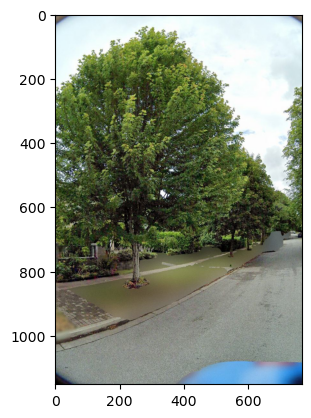

In [3]:
### Visualize sample image in the training dataset

def display_img(img,label):
    print(f"Label : {train_dataset_0.classes[label]}")
    plt.imshow(img.permute(1,2,0)) #reshape image from (3, H, W) to (H, W, 3)

# Select image from index
image = 1
    
# Display the first image in the dataset
display_img(*train_dataset_0[image])



# Experiment with Image Augmentations

C:\Users\talake2\AppData\Local\anaconda3\envs\tensorflow_210\lib\site-packages\torchvision\transforms\functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(


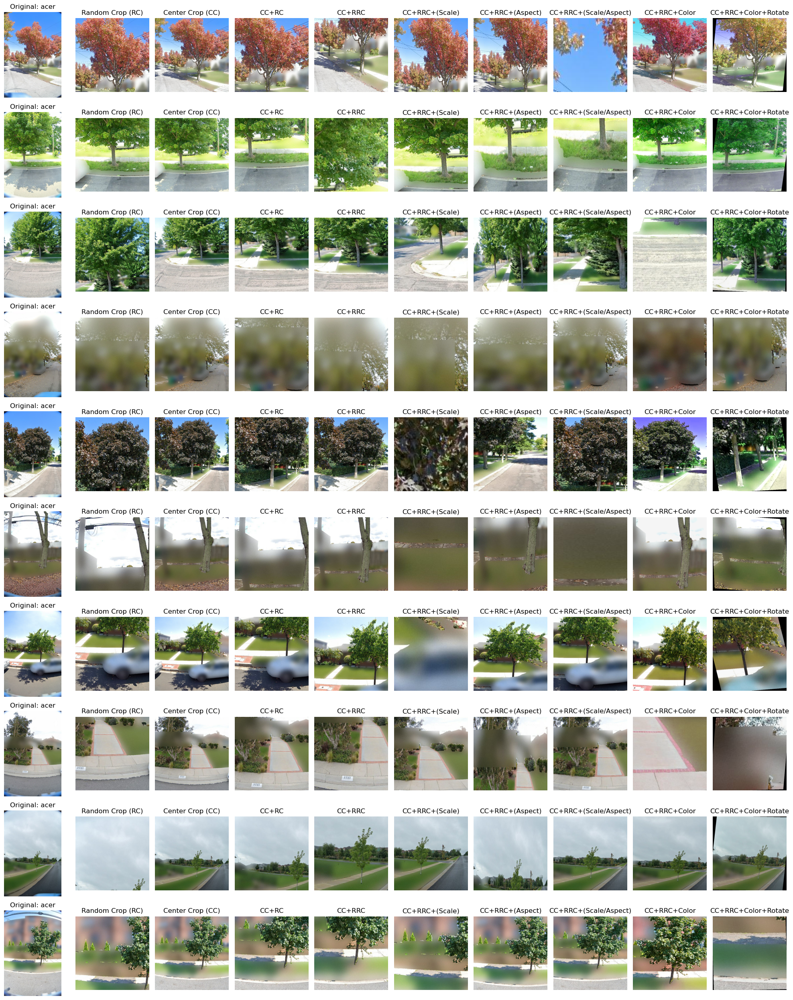

In [4]:
# Define a function to display images
def display_img_aug(ax, img_label, title):
    img, label = img_label
    ax.imshow(img.permute(1, 2, 0))
    ax.set_title(title)
    ax.axis('off')

# Display the original image and augmented images
fig, axs = plt.subplots(10, 10, figsize=(20, 25))  # 10 rows, 8 columns

# Select images from index
images = range(10, 20)

# Original Images
for i, image in enumerate(images):
    display_img_aug(axs[i, 0], train_dataset_0[image], f"Original: {train_dataset_0.classes[train_dataset_0[image][1]]}")

# Augmented Images
for i, image in enumerate(images):
    display_img_aug(axs[i, 1], train_dataset_1[image], "Random Crop (RC)")
    display_img_aug(axs[i, 2], train_dataset_2[image], "Center Crop (CC)")
    display_img_aug(axs[i, 3], train_dataset_3[image], "CC+RC")
    display_img_aug(axs[i, 4], train_dataset_4[image], "CC+RRC")
    display_img_aug(axs[i, 5], train_dataset_5[image], "CC+RRC+(Scale)")
    display_img_aug(axs[i, 6], train_dataset_6[image], "CC+RRC+(Aspect)")
    display_img_aug(axs[i, 7], train_dataset_7[image], "CC+RRC+(Scale/Aspect)")
    display_img_aug(axs[i, 8], train_dataset_8[image], "CC+RRC+Color")
    display_img_aug(axs[i, 9], train_dataset_9[image], "CC+RRC+Color+Rotate")

plt.tight_layout()

# Save the figure
#plt.savefig("output_images.png")

# Show the plot
plt.show()


# Define Image Augmentations for iNaturalist

In [5]:

# Define dataset path containing folders of tree genera
training_destination_root = r"C:\Users\talake2\Desktop\auto_arborist_cvpr2022_v015\pytorch_cnn_classifier\datasets\inaturalist_tiny\training_dataset_tiny_april1824"

# Use Pytorch ImageFolder class to prepare training and testing datasets
train_data_dir = training_destination_root

# Load the training and testing datasets as Pytorch Dataset Classes: https://pytorch.org/docs/stable/data.html
# The Pytorch torchvision.transforms module provides preprocessing functions: https://pytorch.org/vision/stable/transforms.html

# No Image Augmentations
train_transforms_0 = v2.Compose([
    v2.ToImage(),
    v2.ToDtype(torch.float32, scale=True),
])

# Image augmentation with RandomCrop
train_transforms_1 = v2.Compose([
    v2.ToImage(),
    v2.RandomCrop(size=(512, 512), pad_if_needed=True),
    #v2.RandomHorizontalFlip(p=0.5),
    v2.ToDtype(torch.float32, scale=True),
])

# Image augmentation with CenterCrop and resize to 512 x 512
train_transforms_2 = v2.Compose([
    v2.ToImage(),
    v2.CenterCrop(size=(768, 768)),
    v2.Resize(size=(512, 512)),
    #v2.RandomHorizontalFlip(p=0.5),
    v2.ToDtype(torch.float32, scale=True),
])

# Image augmentation with Center Crop (768, 768) and then RandomCrop (512, 512)
train_transforms_3 = v2.Compose([
    v2.ToImage(),
    v2.CenterCrop(size=(768, 768)),
    v2.RandomCrop(size=(512, 512), pad_if_needed=True),
    #v2.RandomHorizontalFlip(p=0.5),
    v2.ToDtype(torch.float32, scale=True),
])


# Image augmentation with Center Crop (768, 768) and then RandomResizeCrop (512, 512) with default scale and ratio values
train_transforms_4 = v2.Compose([
    v2.ToImage(),
    v2.CenterCrop(size=(768, 768)),
    v2.RandomResizedCrop(size=(512, 512), scale = (0.08, 1.0), ratio = (0.75, 1.33333333)),
    #v2.RandomHorizontalFlip(p=0.5),
    v2.ToDtype(torch.float32, scale=True),
])

# Image augmentation with Center Crop (768, 768) and then RandomResizeCrop (512, 512) with greater scaling range
train_transforms_5 = v2.Compose([
    v2.ToImage(),
    v2.CenterCrop(size=(768, 768)),
    v2.RandomResizedCrop(size=(512, 512), scale = (0.01, 1.0), ratio = (0.75, 1.33333333)),
    #v2.RandomHorizontalFlip(p=0.5),
    v2.ToDtype(torch.float32, scale=True),
])


# Image augmentation with Center Crop (768, 768) and then RandomResizeCrop (512, 512) with greater aspect ratio range
train_transforms_6 = v2.Compose([
    v2.ToImage(),
    v2.CenterCrop(size=(768, 768)),
    v2.RandomResizedCrop(size=(512, 512), scale = (0.08, 1.0), ratio = (0.1, 3.0)),
    #v2.RandomHorizontalFlip(p=0.5),
    v2.ToDtype(torch.float32, scale=True),
])


# Image augmentation with Center Crop (768, 768) and then RandomResizeCrop (512, 512) with greater scaling and aspect ratio range
train_transforms_7 = v2.Compose([
    v2.ToImage(),
    v2.CenterCrop(size=(768, 768)),
    v2.RandomResizedCrop(size=(512, 512), scale = (0.01, 1.0), ratio = (0.5, 2.0)),
    #v2.RandomHorizontalFlip(p=0.5),
    v2.ToDtype(torch.float32, scale=True),
])


# Adding ColorJitter
train_transforms_8 = v2.Compose([
    v2.ToImage(),
    v2.CenterCrop(size=(768, 768)),
    v2.RandomResizedCrop(size=(512, 512)),
    #v2.RandomHorizontalFlip(p=0.5),
    v2.ColorJitter(brightness = (0.1), contrast = (0.1), saturation = (0.1), hue = (0.1)),
    v2.ToDtype(torch.float32, scale=True),
])


# Adding Random Rotations and Shears
train_transforms_9 = v2.Compose([
    v2.ToImage(),
    v2.CenterCrop(size=(768, 768)),
    v2.RandomResizedCrop(size=(512, 512), scale = (0.01, 2.0), ratio = (0.75, 1.33333333)),
    #v2.RandomHorizontalFlip(p=0.5),
    v2.ColorJitter(brightness = (0.1), contrast = (0.1), saturation = (0.1), hue = (0.1)),
    v2.RandomAffine(degrees = 5, translate=None, scale=None, shear = 10),
    v2.ToDtype(torch.float32, scale=True),
])


# Create the image datasets with different transformations
train_dataset_0 = ImageFolder(train_data_dir, transform = train_transforms_0) # No image augmentations
train_dataset_1 = ImageFolder(train_data_dir, transform = train_transforms_1) # Random Crop (512 x 512)
train_dataset_2 = ImageFolder(train_data_dir, transform = train_transforms_2) # Center Crop (768 x 768)
train_dataset_3 = ImageFolder(train_data_dir, transform = train_transforms_3) # Center Crop (768 x 768) and Random Crop (512 x 512)
train_dataset_4 = ImageFolder(train_data_dir, transform = train_transforms_4) # Center Crop (768 x 768) and Random Resized Crop (Default, 512 x 512)
train_dataset_5 = ImageFolder(train_data_dir, transform = train_transforms_5) # Center Crop (768 x 768) and Random Resized Crop (Scale Increased, 512 x 512)
train_dataset_6 = ImageFolder(train_data_dir, transform = train_transforms_6) # Center Crop (768 x 768) and Random Resized Crop (Aspect Ratio Increased, 512 x 512)
train_dataset_7 = ImageFolder(train_data_dir, transform = train_transforms_7) # Center Crop (768 x 768) and Random Resized Crop (Scale and Aspect Ratio Increased, 512 x 512)
train_dataset_8 = ImageFolder(train_data_dir, transform = train_transforms_8) # Center Crop (768 x 768) and Random Resized Crop (Scale and Aspect Ratio, 512 x 512) and ColorJitter (0.1)
train_dataset_9 = ImageFolder(train_data_dir, transform = train_transforms_9) # Center Crop (768 x 768) and Random Resized Crop (Scale and Aspect Ratio, 512 x 512) and ColorJitter (0.1) and Rotation (5 degrees)


# Examine the train_dataset object
train_dataset_0.classes

# Examine image dimensions: (3 channels, height 64, width 64)
img, label = train_dataset_0[0]
print(img.shape,label)


['acer',
 'ailanthus',
 'betula',
 'citrus',
 'cupaniopsis',
 'erythrina',
 'fraxinus',
 'gleditsia',
 'juglans',
 'juniperus',
 'magnolia',
 'phoenix',
 'picea',
 'pinus',
 'prunus',
 'pseudotsuga',
 'pyrus',
 'quercus',
 'rhus',
 'sequoia',
 'taxodium',
 'thuja',
 'tilia',
 'ulmus',
 'washingtonia']

torch.Size([3, 2048, 1933]) 0


# Display single image

Label : acer


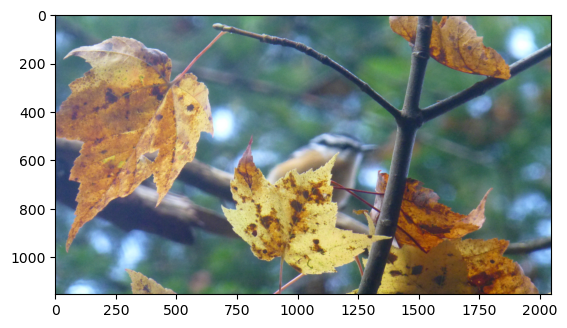

In [6]:
### Visualize sample image in the training dataset

def display_img(img,label):
    print(f"Label : {train_dataset_0.classes[label]}")
    plt.imshow(img.permute(1,2,0)) #reshape image from (3, H, W) to (H, W, 3)

# Select image from index
image = 1
    
# Display the first image in the dataset
display_img(*train_dataset_0[image])



# Experiment with Image Augmentations

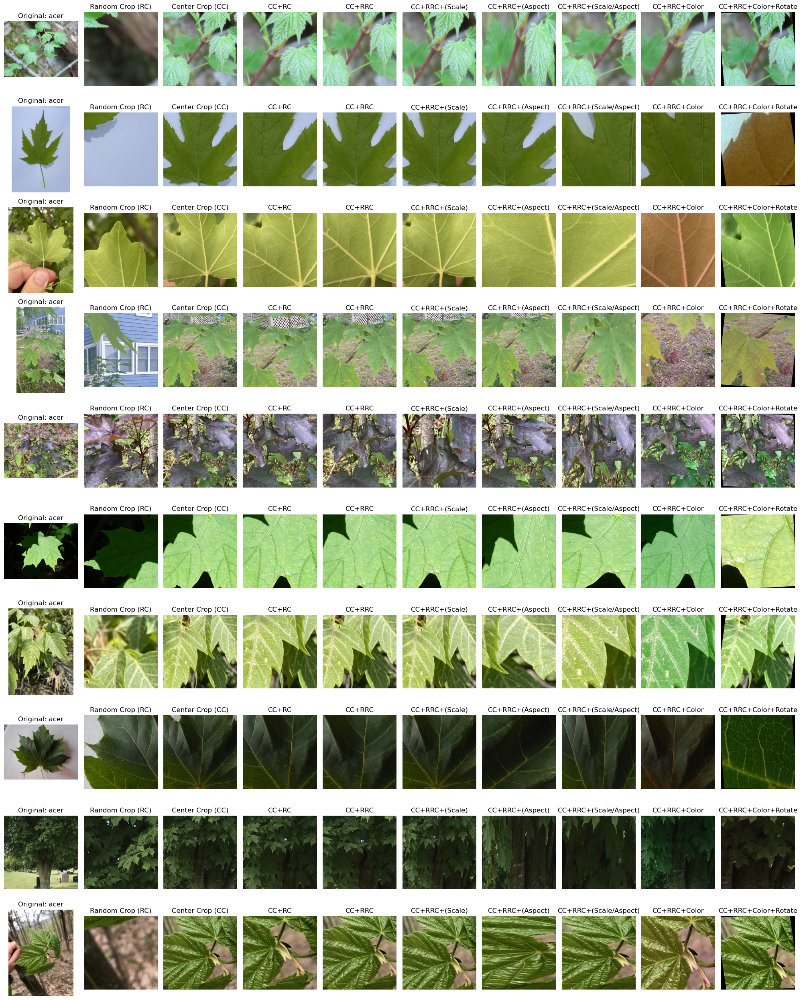

In [7]:
# Define a function to display images
def display_img_aug(ax, img_label, title):
    img, label = img_label
    ax.imshow(img.permute(1, 2, 0))
    ax.set_title(title)
    ax.axis('off')

# Display the original image and augmented images
fig, axs = plt.subplots(10, 10, figsize=(20, 25))  # 10 rows, 8 columns

# Select images from index
images = range(10, 20)

# Original Images
for i, image in enumerate(images):
    display_img_aug(axs[i, 0], train_dataset_0[image], f"Original: {train_dataset_0.classes[train_dataset_0[image][1]]}")

# Augmented Images
for i, image in enumerate(images):
    display_img_aug(axs[i, 1], train_dataset_1[image], "Random Crop (RC)")
    display_img_aug(axs[i, 2], train_dataset_2[image], "Center Crop (CC)")
    display_img_aug(axs[i, 3], train_dataset_3[image], "CC+RC")
    display_img_aug(axs[i, 4], train_dataset_4[image], "CC+RRC")
    display_img_aug(axs[i, 5], train_dataset_5[image], "CC+RRC+(Scale)")
    display_img_aug(axs[i, 6], train_dataset_6[image], "CC+RRC+(Aspect)")
    display_img_aug(axs[i, 7], train_dataset_7[image], "CC+RRC+(Scale/Aspect)")
    display_img_aug(axs[i, 8], train_dataset_8[image], "CC+RRC+Color")
    display_img_aug(axs[i, 9], train_dataset_9[image], "CC+RRC+Color+Rotate")

plt.tight_layout()

# Save the figure
#plt.savefig("output_images.png")

# Show the plot
plt.show()


# Define Image Augmentations for "Curated" iNaturalist

In [8]:

# Define dataset path containing folders of tree genera
training_destination_root = r"D:\blaginh\tree_classification\aa_inat_combined\training_data_top1000_may724_curated"

# Use Pytorch ImageFolder class to prepare training and testing datasets
train_data_dir = training_destination_root

# Load the training and testing datasets as Pytorch Dataset Classes: https://pytorch.org/docs/stable/data.html
# The Pytorch torchvision.transforms module provides preprocessing functions: https://pytorch.org/vision/stable/transforms.html

# No Image Augmentations
train_transforms_0 = v2.Compose([
    v2.ToImage(),
    v2.ToDtype(torch.float32, scale=True),
])

# Image augmentation with RandomCrop
train_transforms_1 = v2.Compose([
    v2.ToImage(),
    v2.RandomCrop(size=(512, 512), pad_if_needed=True),
    #v2.RandomHorizontalFlip(p=0.5),
    v2.ToDtype(torch.float32, scale=True),
])

# Image augmentation with CenterCrop and resize to 512 x 512
train_transforms_2 = v2.Compose([
    v2.ToImage(),
    v2.CenterCrop(size=(768, 768)),
    v2.Resize(size=(512, 512)),
    #v2.RandomHorizontalFlip(p=0.5),
    v2.ToDtype(torch.float32, scale=True),
])

# Image augmentation with Center Crop (768, 768) and then RandomCrop (512, 512)
train_transforms_3 = v2.Compose([
    v2.ToImage(),
    v2.CenterCrop(size=(768, 768)),
    v2.RandomCrop(size=(512, 512), pad_if_needed=True),
    #v2.RandomHorizontalFlip(p=0.5),
    v2.ToDtype(torch.float32, scale=True),
])


# Image augmentation with Center Crop (768, 768) and then RandomResizeCrop (512, 512) with default scale and ratio values
train_transforms_4 = v2.Compose([
    v2.ToImage(),
    v2.CenterCrop(size=(768, 768)),
    v2.RandomResizedCrop(size=(512, 512), scale = (0.08, 1.0), ratio = (0.75, 1.33333333)),
    #v2.RandomHorizontalFlip(p=0.5),
    v2.ToDtype(torch.float32, scale=True),
])

# Image augmentation with Center Crop (768, 768) and then RandomResizeCrop (512, 512) with greater scaling range
train_transforms_5 = v2.Compose([
    v2.ToImage(),
    v2.CenterCrop(size=(768, 768)),
    v2.RandomResizedCrop(size=(512, 512), scale = (0.01, 1.0), ratio = (0.75, 1.33333333)),
    #v2.RandomHorizontalFlip(p=0.5),
    v2.ToDtype(torch.float32, scale=True),
])


# Image augmentation with Center Crop (768, 768) and then RandomResizeCrop (512, 512) with greater aspect ratio range
train_transforms_6 = v2.Compose([
    v2.ToImage(),
    v2.CenterCrop(size=(768, 768)),
    v2.RandomResizedCrop(size=(512, 512), scale = (0.08, 1.0), ratio = (0.1, 3.0)),
    #v2.RandomHorizontalFlip(p=0.5),
    v2.ToDtype(torch.float32, scale=True),
])


# Image augmentation with Center Crop (768, 768) and then RandomResizeCrop (512, 512) with greater scaling and aspect ratio range
train_transforms_7 = v2.Compose([
    v2.ToImage(),
    v2.CenterCrop(size=(768, 768)),
    v2.RandomResizedCrop(size=(512, 512), scale = (0.01, 1.0), ratio = (0.5, 2.0)),
    #v2.RandomHorizontalFlip(p=0.5),
    v2.ToDtype(torch.float32, scale=True),
])


# Adding ColorJitter
train_transforms_8 = v2.Compose([
    v2.ToImage(),
    v2.CenterCrop(size=(768, 768)),
    v2.RandomResizedCrop(size=(512, 512)),
    v2.RandomHorizontalFlip(p=0.5),
    v2.ColorJitter(brightness = (0.1), contrast = (0.1), saturation = (0.1), hue = (0.01)),
    v2.ToDtype(torch.float32, scale=True),
])


# Adding Random Rotations and Shears
train_transforms_9 = v2.Compose([
    v2.ToImage(),
    v2.CenterCrop(size=(768, 768)),
    v2.RandomResizedCrop(size=(512, 512), scale = (0.08, 1.0), ratio = (0.75, 1.33333333)),
    v2.RandomHorizontalFlip(p=0.5),
    v2.ColorJitter(brightness = (0.1), contrast = (0.1), saturation = (0.1), hue = (0.01)),
    v2.RandomAffine(degrees = 5, translate=None, scale=None, shear = 5),
    v2.ToDtype(torch.float32, scale=True),
])


# Create the image datasets with different transformations
train_dataset_0 = ImageFolder(train_data_dir, transform = train_transforms_0) # No image augmentations
train_dataset_1 = ImageFolder(train_data_dir, transform = train_transforms_1) # Random Crop (512 x 512)
train_dataset_2 = ImageFolder(train_data_dir, transform = train_transforms_2) # Center Crop (768 x 768)
train_dataset_3 = ImageFolder(train_data_dir, transform = train_transforms_3) # Center Crop (768 x 768) and Random Crop (512 x 512)
train_dataset_4 = ImageFolder(train_data_dir, transform = train_transforms_4) # Center Crop (768 x 768) and Random Resized Crop (Default, 512 x 512)
train_dataset_5 = ImageFolder(train_data_dir, transform = train_transforms_5) # Center Crop (768 x 768) and Random Resized Crop (Scale Increased, 512 x 512)
train_dataset_6 = ImageFolder(train_data_dir, transform = train_transforms_6) # Center Crop (768 x 768) and Random Resized Crop (Aspect Ratio Increased, 512 x 512)
train_dataset_7 = ImageFolder(train_data_dir, transform = train_transforms_7) # Center Crop (768 x 768) and Random Resized Crop (Scale and Aspect Ratio Increased, 512 x 512)
train_dataset_8 = ImageFolder(train_data_dir, transform = train_transforms_8) # Center Crop (768 x 768) and Random Resized Crop (Scale and Aspect Ratio, 512 x 512) and ColorJitter (0.1)
train_dataset_9 = ImageFolder(train_data_dir, transform = train_transforms_9) # Center Crop (768 x 768) and Random Resized Crop (Scale and Aspect Ratio, 512 x 512) and ColorJitter (0.1) and Rotation (5 degrees)


# Examine the train_dataset object
train_dataset_0.classes

# Examine image dimensions: (3 channels, height 64, width 64)
img, label = train_dataset_0[0]
print(img.shape,label)


['acer',
 'ailanthus',
 'betula',
 'citrus',
 'cupaniopsis',
 'erythrina',
 'fraxinus',
 'gleditsia',
 'juglans',
 'juniperus',
 'magnolia',
 'phoenix',
 'picea',
 'pinus',
 'prunus',
 'pseudotsuga',
 'pyrus',
 'quercus',
 'rhus',
 'sequoia',
 'taxodium',
 'thuja',
 'tilia',
 'ulmus',
 'washingtonia']

torch.Size([3, 1152, 768]) 0


# Display single image

Label : ailanthus


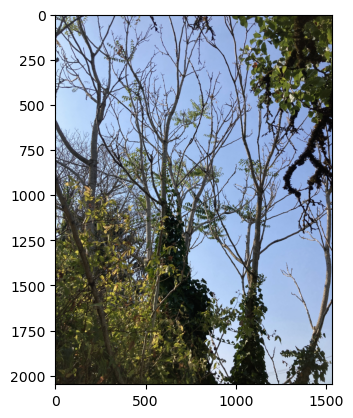

In [9]:
### Visualize sample image in the training dataset

def display_img(img,label):
    print(f"Label : {train_dataset_0.classes[label]}")
    plt.imshow(img.permute(1,2,0)) #reshape image from (3, H, W) to (H, W, 3)

# Select image from index
image = 2500
    
# Display the first image in the dataset
display_img(*train_dataset_0[image])



# Experiment with Image Augmentations

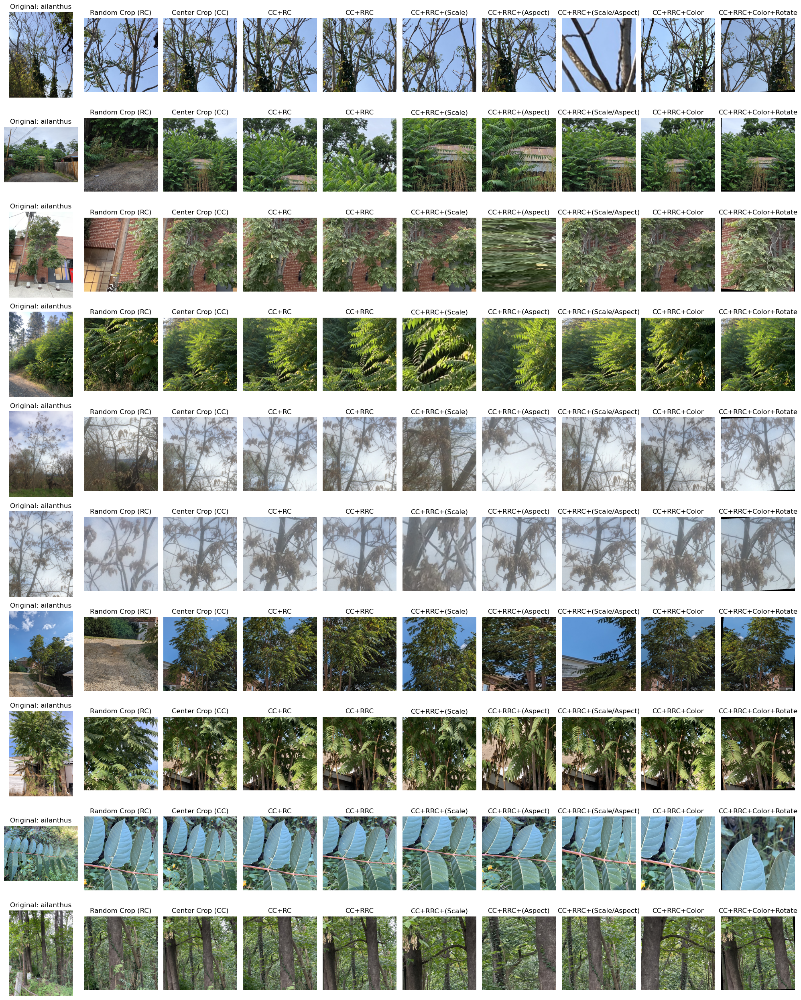

In [10]:
# Define a function to display images
def display_img_aug(ax, img_label, title):
    img, label = img_label
    ax.imshow(img.permute(1, 2, 0))
    ax.set_title(title)
    ax.axis('off')

# Display the original image and augmented images
fig, axs = plt.subplots(10, 10, figsize=(20, 25))  # 10 rows, 8 columns

# Select images from index
images = range(2500,2510)

# Original Images
for i, image in enumerate(images):
    display_img_aug(axs[i, 0], train_dataset_0[image], f"Original: {train_dataset_0.classes[train_dataset_0[image][1]]}")

# Augmented Images
for i, image in enumerate(images):
    display_img_aug(axs[i, 1], train_dataset_1[image], "Random Crop (RC)")
    display_img_aug(axs[i, 2], train_dataset_2[image], "Center Crop (CC)")
    display_img_aug(axs[i, 3], train_dataset_3[image], "CC+RC")
    display_img_aug(axs[i, 4], train_dataset_4[image], "CC+RRC")
    display_img_aug(axs[i, 5], train_dataset_5[image], "CC+RRC+(Scale)")
    display_img_aug(axs[i, 6], train_dataset_6[image], "CC+RRC+(Aspect)")
    display_img_aug(axs[i, 7], train_dataset_7[image], "CC+RRC+(Scale/Aspect)")
    display_img_aug(axs[i, 8], train_dataset_8[image], "CC+RRC+Color")
    display_img_aug(axs[i, 9], train_dataset_9[image], "CC+RRC+Color+Rotate")

plt.tight_layout()

# Save the figure
#plt.savefig("output_images.png")

# Show the plot
plt.show()


In [ ]:
# EOF